# **initial**

In [ ]:
import pandas as pd
data = pd.read_csv('/content/train.csv', on_bad_lines='skip')
data.columns = ['category','subcategory', 'crime_info']
data.head(50)

,category,subcategory,crime_info
0,Online and Social Media Related Crime,Cyber Bullying Stalking Sexting,I had continue received random calls and abusi...
1,Online Financial Fraud,Fraud CallVishing,The above fraudster is continuously messaging ...
2,Online Gambling Betting,Online Gambling Betting,He is acting like a police and demanding for m...
3,Online and Social Media Related Crime,Online Job Fraud,In apna Job I have applied for job interview f...
4,Online Financial Fraud,Fraud CallVishing,I received a call from lady stating that she w...
5,Online Financial Fraud,UPI Related Frauds,FRAUD \t UPI PAYTM \r\nBANK \tPunjab National ...
6,Online Financial Fraud,Fraud CallVishing,Sir I am Prabhat Singh jat An app on playstor...
7,Online Financial Fraud,Internet Banking Related Fraud,FINANCIAL FRAUD RS
8,RapeGang Rape RGRSexually Abusive Content,NaN,I got the message on Whatsapp to my number The...
9,Any Other Cyber Crime,Other,Details entered in pdf file Person posing as A...


**Null value removed**

In [ ]:
filtered_data = data[data['crime_info'].notnull() & data['subcategory'].notnull() & data['category'].notnull()]
filtered_data.head(20)
len(filtered_data)

87074

**Mapping category column**

In [ ]:
# Get distinct values in the 'category' column
distinct_categories = data['category'].unique()

# Print distinct categories
print(distinct_categories)


['Online and Social Media Related Crime' 'Online Financial Fraud'
 'Online Gambling  Betting' 'RapeGang Rape RGRSexually Abusive Content'
 'Any Other Cyber Crime' 'Cyber Attack/ Dependent Crimes'
 'Cryptocurrency Crime' 'Sexually Explicit Act'
 'Sexually Obscene material'
 'Hacking  Damage to computercomputer system etc' 'Cyber Terrorism'
 'Child Pornography CPChild Sexual Abuse Material CSAM'
 'Online Cyber Trafficking' 'Ransomware' 'Report Unlawful Content']


In [ ]:
# Step 3: Mapping dictionary for categories
category_mapping = {
    'Women/Child Related Crime': [
        'RapeGang Rape RGRSexually Abusive Content',
        'Child Pornography CPChild Sexual Abuse Material CSAM',
        'Sexually Explicit Act',
        'Sexually Obscene material',
        'Online Cyber Trafficking'
    ],
    'Financial Fraud Crimes': [
        'Online Financial Fraud',
        'Cryptocurrency Crime',
        'Ransomware',
        'Online Gambling  Betting'
    ],
    'Other Cyber Crime': [
        'Online and Social Media Related Crime',
        'Any Other Cyber Crime',
        'Cyber Attack/ Dependent Crimes',
        'Hacking  Damage to computercomputer system etc',
        'Cyber Terrorism',
        'Report Unlawful Content'
    ]
}


reverse_mapping = {value: key for key, values in category_mapping.items() for value in values}

filtered_data['mapped_category'] = filtered_data['category'].map(reverse_mapping)


unmapped_categories = filtered_data[filtered_data['mapped_category'].isna()]
if not unmapped_categories.empty:
    print("\nUnmapped Categories Found:")
    print(unmapped_categories)


filtered_data.dropna(subset=['mapped_category'], inplace=True)

filtered_data['category'] = filtered_data['mapped_category']
filtered_data.drop(columns=['mapped_category'], inplace=True)

filtered_data.head(20)
print("NaN values in columns:/n", filtered_data.isnull().sum())

NaN values in columns:/n category       0
subcategory    0
crime_info     0
dtype: int64


<ipython-input-4-8ec8109dc5fb>:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['mapped_category'] = filtered_data['category'].map(reverse_mapping)
<ipython-input-4-8ec8109dc5fb>:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data.dropna(subset=['mapped_category'], inplace=True)
<ipython-input-4-8ec8109dc5fb>:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

In [ ]:
# filtered_data['category'].unique()
filtered_data['subcategory'].isnull().sum()

0

In [ ]:
filtered_data[filtered_data['category'] == 'Women/Child Related Crime']

,category,subcategory,crime_info
371,Women/Child Related Crime,Online Trafficking,SIR I HAVE GET SMS WITH PRE APPORVED LOAN IJU...
427,Women/Child Related Crime,Online Trafficking,this number frauder call me I had ordered on ...
639,Women/Child Related Crime,Online Trafficking,I got a number from a dating app I texted her...
2541,Women/Child Related Crime,Online Trafficking,I have received a notification by chrome he sa...
2567,Women/Child Related Crime,Online Trafficking,Nenu sex video Chuchinatu Create Chesaru Amoun...
...,...,...,...
91345,Women/Child Related Crime,Online Trafficking,one day morning Dec one phone cal recied His...
91552,Women/Child Related Crime,Online Trafficking,online paytm customer care check in google and...
91958,Women/Child Related Crime,Online Trafficking,Amozon pe hum karadidne par profit ka jasha de...
92349,Women/Child Related Crime,Online Trafficking,MY AXIS BANK ACCOUNT DEDUCT RS MR RAJ MALHOTRA...


In [ ]:
file_path = 'filtered_data.csv'  # You can change this to your desired path

# Save the DataFrame to CSV
filtered_data.to_csv(file_path, index=False)

print(f"Filtered data saved to: {file_path}")

Filtered data saved to: filtered_data.csv


# **text-preprocessing**

In [ ]:
import pandas as pd
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# Download NLTK data files
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')

# Load the data
data = pd.read_csv('/content/filtered_data.csv', on_bad_lines='skip')
data.columns = ['category', 'subcategory', 'crime_info']

# Step 1: Filter out rows with null values
filtered_data = data[data['crime_info'].notnull() & data['subcategory'].notnull() & data['category'].notnull()]

# Step 2: Define text preprocessing functions
def clean_text(text):
    # Convert to lowercase
    text = text.lower()
    # Remove special characters, numbers, and punctuation
    text = re.sub(r'[^a-z\s]', '', text)
    # Remove extra spaces
    text = re.sub(r'\s+', ' ', text).strip()
    return text

def tokenize_and_lemmatize(text):
    # Tokenize the text
    tokens = word_tokenize(text)
    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    tokens = [word for word in tokens if word not in stop_words]
    # Lemmatize the tokens
    lemmatizer = WordNetLemmatizer()
    lemmatized_tokens = [lemmatizer.lemmatize(word) for word in tokens]
    return ' '.join(lemmatized_tokens)


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


In [ ]:

# Step 3: Apply text preprocessing to the 'crime_info' column
filtered_data['crime_info'] = filtered_data['crime_info'].apply(clean_text)
filtered_data['crime_info'] = filtered_data['crime_info'].apply(tokenize_and_lemmatize)

# Step 4: Verify the cleaned data
print(filtered_data[['crime_info']].head(10))

# # Save the cleaned data for further analysis
# file_path = 'cleaned_data.csv'
# filtered_data.to_csv(file_path, index=False)
# print(f"Cleaned data saved to: {file_path}")
filtered_data.head()

                                          crime_info
0  continue received random call abusive message ...
1  fraudster continuously messaging asking pay mo...
2  acting like police demanding money adding sect...
3  apna job applied job interview telecalling res...
4  received call lady stating send new phone vivo...
5  fraud upi paytm bank punjab national bank incl...
6  sir prabhat singh jat app playstore name rupee...
7                                  financial fraud r
8  detail entered pdf file person posing army off...
9  received whatsapp number happn dating app text...


,category,subcategory,crime_info
0,Other Cyber Crime,Cyber Bullying Stalking Sexting,continue received random call abusive message ...
1,Financial Fraud Crimes,Fraud CallVishing,fraudster continuously messaging asking pay mo...
2,Financial Fraud Crimes,Online Gambling Betting,acting like police demanding money adding sect...
3,Other Cyber Crime,Online Job Fraud,apna job applied job interview telecalling res...
4,Financial Fraud Crimes,Fraud CallVishing,received call lady stating send new phone vivo...


# **EDA**

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
<ipython-input-10-8d69ce504239>:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=filtered_data, x='category', palette='Set2')


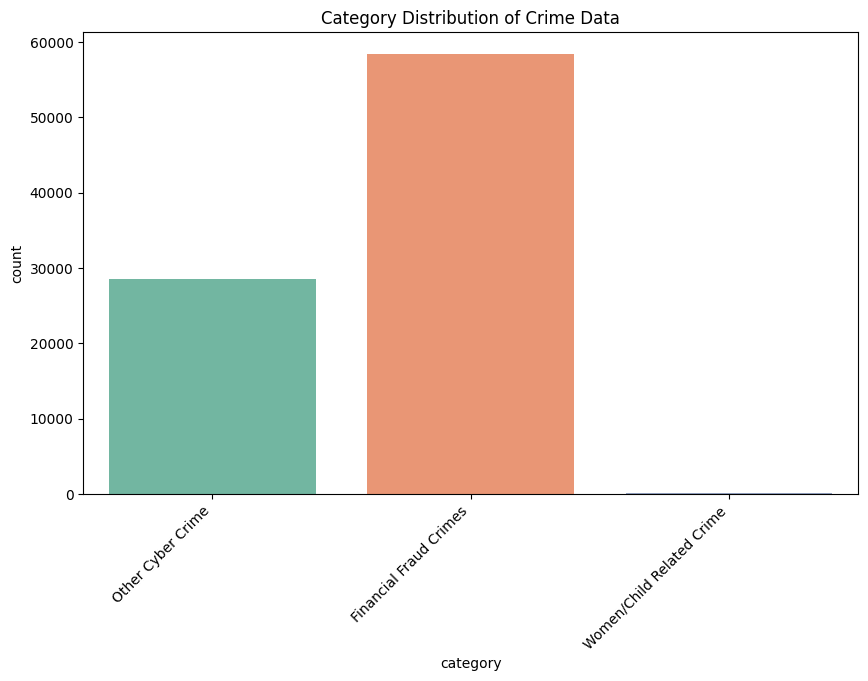

Most Common Words:
account: 63659
amount: 56125
bank: 45950
number: 44010
fraud: 42641
call: 36793
money: 34806
please: 32196
r: 31327
total: 26321
continue received random call abusive message whatsapp someone added number unknown facebook group name girl still getting call unknown number pls help sort issue soon possible thank apna job applied job interview telecalling resource management wrote twelve hundred charged security amount laptop work home given interview given address next day charged twelve hundred six hundred money name insurance referred job calling work laptop neither work home kindly please take action soon possible possible please help recover financial loss detail entered pdf file person posing army officer msg u want place rent confirm account want u transfer account confirmed transfer back received whatsapp number happn dating app texted whatsapp video call asked show face asked remove clothes recorded video asking send money sent asking kindly help situation also

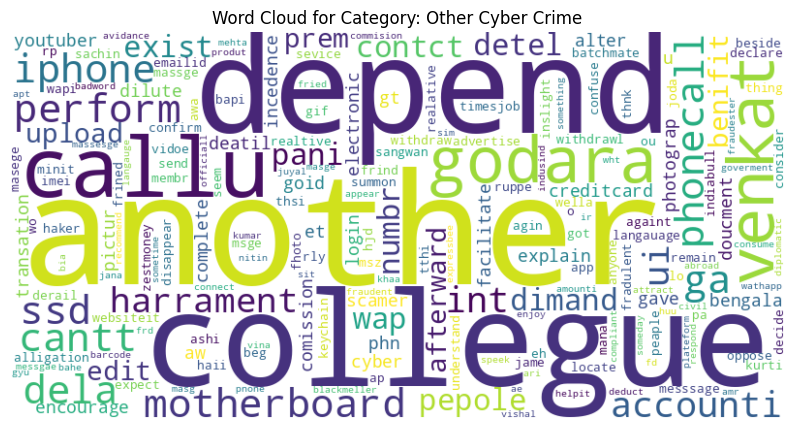

fraudster continuously messaging asking pay money send fake cropped nude photo contact whatsapp unaware recieved contact list phone please help acting like police demanding money adding section text message request take immediate action frequently harassing message reference please find attached file received call lady stating send new phone vivo received parcel post th february kurnool head post office received mobile fraud upi paytm bank punjab national bank including oriental bank commerce united bank india account number total amount please hold reverse total amount complaint account take necessary action sir prabhat singh jat app playstore name rupeestarsago never applied loan app copied contact list asking loan repayment calling contact relative abusing himher mentally harrasing please take strict action defaming infront contact relative forced suicide able swith mobile phone calling continuously abusing closed commit suiside financial fraud r fraud debitcredit card fraudsim swap

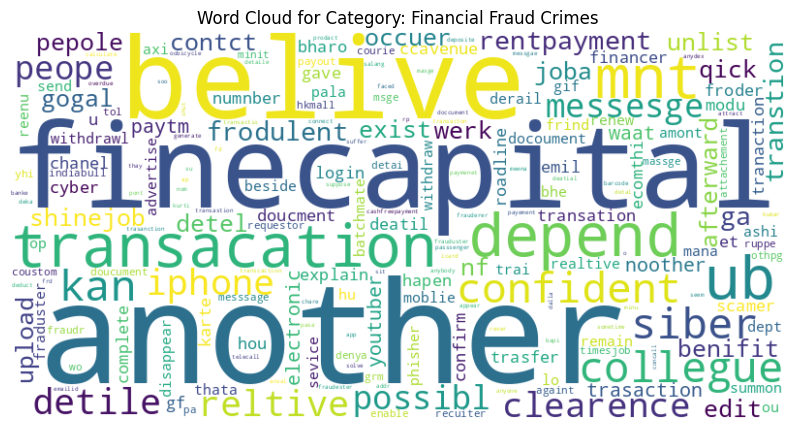

sir get sm pre apporved loan ijust click check without permission transfer account feb two application orange rainbow feb call whatsapp force deposit ask loan agreement thery refuse provide loan agreementonly day ammounrt reached called every time anaother whatsapp also used vulgur language forced deposit loan amount kindly give solution number frauder call ordered amazon money deducted order completed called amazon customer care get call got call said talking amazon customer care got process done debit card deducted money pls help sir got number dating app texted suddenly got nude video call blackmailing video asking money paid r phonepe kishan modak asking threatening viral video please help received notification chrome say scratch card scratched card account balance deducted please help poor farmer please catch hacker money nenu sex video chuchinatu create chesaru amount phonepe leda google pay send cheyalanta sir leda video facebook youtube social medium upload chestaranta sir plz 

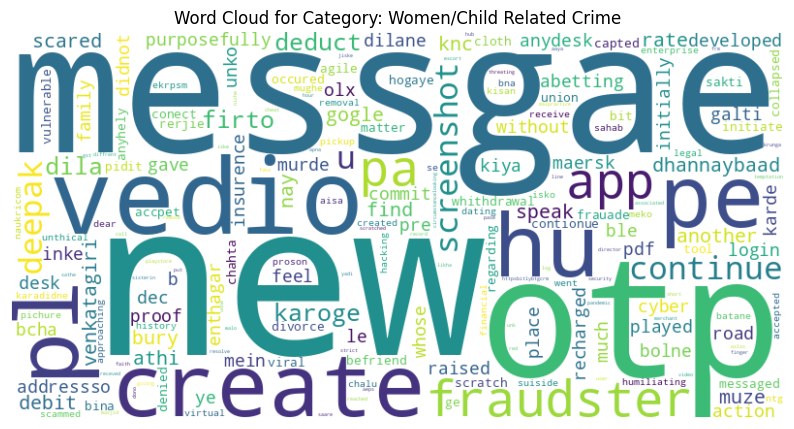

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from collections import Counter
import nltk

# Download NLTK stopwords if not already downloaded
nltk.download('punkt')
nltk.download('stopwords')

# Step 1: Load your dataset (replace with your actual data source)

# Step 2: Visualize the Category Distribution
plt.figure(figsize=(10, 6))
sns.countplot(data=filtered_data, x='category', palette='Set2')
plt.title('Category Distribution of Crime Data')
plt.xticks(rotation=45, ha='right')
plt.show()

# Step 3: Analyze Word Frequencies
# Combine all text in the dataset into one large string for frequency analysis
all_text = ' '.join(filtered_data['crime_info'].astype(str))

# Tokenize the text and remove stopwords
stop_words = set(stopwords.words('english'))
tokens = word_tokenize(all_text.lower())  # Lowercase and tokenize
filtered_tokens = [word for word in tokens if word.isalpha() and word not in stop_words]

# Count the word frequencies
word_counts = Counter(filtered_tokens)

# Display the 10 most common words
common_words = word_counts.most_common(10)
print("Most Common Words:")
for word, count in common_words:
    print(f"{word}: {count}")

# Step 4: Generate Word Clouds for Each Category
categories = filtered_data['category'].unique()
for category in categories:
    # Get all text for the category
    category_text = ' '.join(filtered_data[filtered_data['category'] == category]['crime_info'].astype(str))
    print(category_text)
    # Remove duplicate words by converting to a set
    unique_words = ' '.join(set(category_text.split()))

    # Generate the WordCloud for unique words
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(unique_words)

    # Plot Word Cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for Category: {category}')
    plt.show()



# **spelling correction**

Category: Other Cyber Crime = nutramin dx infokrvirtualservicescom razro trick another kehjo forged viduthalai jaiso kotha surojitdegmailcom telecommunication tracable vanguna idnamed neru bansal enteerprises resoect yamena tjapskbskgovingmailcom withdrawatmspcnjcashwdl inse sende rangadas pollution immediatly dlal newcashbus tring khariz underprivileged chukka saikia broked callsother haiand attachmetnt pananna tratment derreckbrowngmailcom beja ujhe reasonable wahts chotu bcc thiamethoxamwg holi galliye akumalla educate repetation privided indigo resideatial dollers belatedly played manaccordingly harshadkumarlakumgujgoveduin mhujhe distburdawan sounding dedeucted victim lambe otg lagay moneygold attching shivalyam endorsement belive moneyat kantoria accordingly obvious lehnegas dalalstreetscom akarabar inspite everythinghe dengesir prantika interchanged resonsibity hill nakuricom struggling operte insurence cen chatlist vyu maatter lired aisha memory fenil wana kanagarajan vague hya

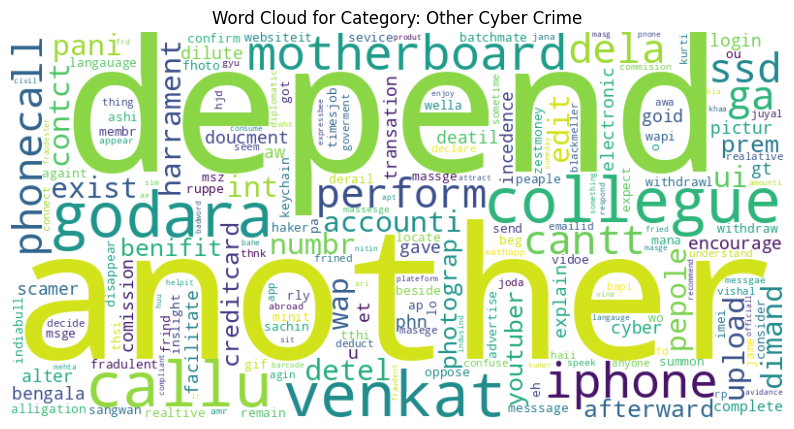

Category: Financial Fraud Crimes = nirudi chorha abax holdstop gautammohankumargmailcom riward dx aphone seetal insatlled sitsmartvijayyahoocoin trick another possiblebecause forged blockedplz kotha telecommunication themwaseem tracable kuresi dfs bansal brics happanes naigaon asei byphone inse barbbundix bankingpay supportexciselicencegovtin guahati pollution immediatly dodge pskotwali mediclaim finecapital karaneke haiand backpls initaiated beja hmlet holi chotu snehapatel reasonable httpscuttlyfloivf bcc khq wahts owes lwbklc educate tharmatagurgmailcom addhaar balanceth suchnakrta nobsppsc dbaya indigo dearest dollers grasp played patnabut iddravinsharmagmailcom kadha chhann throughpaytmupi miscrant gunner falsify mintaly sounding idhemjimahidagmailvcom mraakashaccount victim otg lagay bankcentral karnyat attching ilost belive taransfar mercedesbenz moneyat jobseeker accordingly obvious solutio leeye accountverifycoin khadki airfort cudon inspite batayie wwwvaluekartcom chadrabhan 

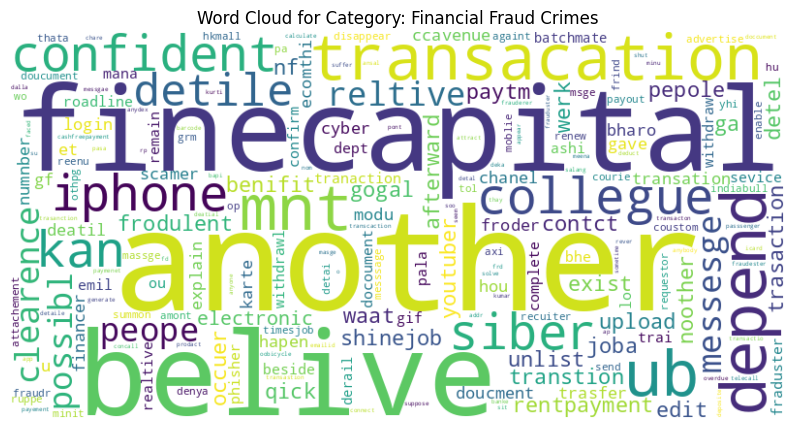

Category: Women/Child Related Crime = karoge dila firto deduct dhannaybaad another bury nay find muze rate scared speak knc gogle debit venkatagiri athi purposefully anydesk much gave galti ble maersk addressso olx developed login b pre raised played initially dilane abetting road pdf dec action without bolne mein ye commit proof desk kiya enthagar cyber recharged feel family murde bcha insurence place unko le whose inke karde didnot whithdrawal messaged contionue capted regarding hogaye cloth initiate anyhely collapsed agile befriend denied frauade pidit occured tool sakti deepaks ge bina bit chahta viral scratch union conect vulnerable divorce matter accpet rerjie humiliating enterprise removal went karadidne approaching created hacking proson chalu suiside dating legal scammed pickup naukricom batane se sahab financial pichure ekrpsm kisan aisa mughe history ntg virtual receive unthical bna meko isko dear accepted httpsbitlybtgcrm pandemic iske threating short call pase jiske masjid

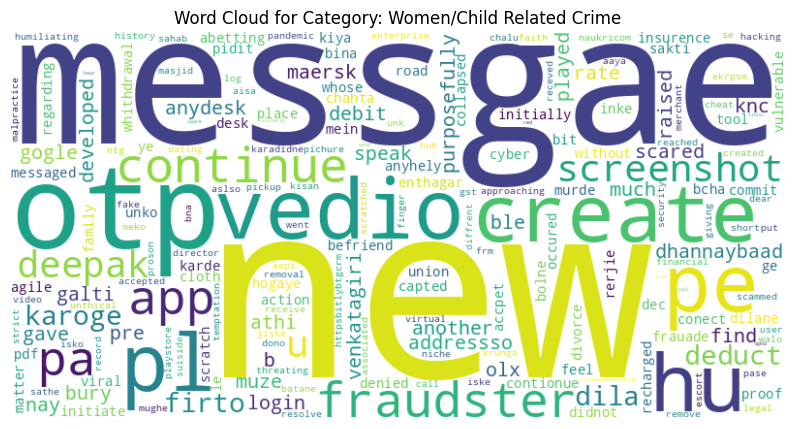

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Step 4: Generate Word Clouds for Each Category
categories = filtered_data['category'].unique()

for category in categories:
    # Get all text for the category
    category_text = ' '.join(filtered_data[filtered_data['category'] == category]['crime_info'].astype(str))

    # Remove duplicate words by converting to a set
    unique_words_set = set(category_text.split())
    unique_words = ' '.join(unique_words_set)

    # Print the category name and the unique words
    print(f"Category: {category} = {unique_words}")

    # Print the number of unique words
    print(f"Number of unique words: {len(unique_words_set)}")

    # Generate the WordCloud for unique words
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(unique_words)

    # Plot Word Cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for Category: {category}')
    plt.show()


# **hinglish words**

In [ ]:
!pip install langid
!pip install indicnlp

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 21.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for langid: filename=langid-1.1.6-py3-none-any.whl size=1941171 sha256=30070b737e78c7f67db3bf7183dc23adffbd97ef6de2b14391587d5e926e2ad8
  Stored in directory: /root/.cache/pip/wheels/23/c8/c6/eed80894918490a175677414d40bd7c851413bbe03d4856c3c
Successfully built langid


In [ ]:
import pandas as pd
import re
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# Download necessary NLTK files
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

import pandas as pd
import re
import nltk
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

# Download necessary NLTK files
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

# Define Hinglish stopwords (use the list you provided)
hinglish_stopwords = set([
    'a', 'aadi', 'aaj', 'aap', 'aapne', 'aata', 'aati', 'aaya', 'aaye', 'ab', 'abbe', 'abbey', 'abe', 'abhi', 'able',
    'about', 'above', 'accha', 'according', 'accordingly', 'acha', 'achcha', 'across', 'actually', 'after', 'afterwards',
    'again', 'against', 'agar', 'ain', 'aint', 'ain\'t', 'aisa', 'aise', 'aisi', 'alag', 'all', 'allow', 'allows', 'almost',
    'alone', 'along', 'already', 'also', 'although', 'always', 'am', 'among', 'amongst', 'an', 'and', 'andar', 'another',
    'any', 'anybody', 'anyhow', 'anyone', 'anything', 'anyway', 'anyways', 'anywhere', 'ap', 'apan', 'apart', 'apna', 'apnaa',
    'apne', 'apni', 'appear', 'are', 'aren', 'arent', 'aren\'t', 'around', 'arre', 'as', 'aside', 'ask', 'asking', 'at', 'aur',
    'avum', 'aya', 'aye', 'baad', 'baar', 'bad', 'bahut', 'bana', 'banae', 'banai', 'banao', 'banaya', 'banaye', 'banayi',
    'banda', 'bande', 'bandi', 'bane', 'bani', 'bas', 'bata', 'batao', 'bc', 'be', 'became', 'because', 'become', 'becomes',
    'becoming', 'been', 'before', 'beforehand', 'behind', 'being', 'below', 'beside', 'besides', 'best', 'better', 'between',
    'beyond', 'bhai', 'bheetar', 'bhi', 'bhitar', 'bht', 'bilkul', 'bohot', 'bol', 'bola', 'bole', 'boli', 'bolo', 'bolta',
    'bolte', 'bolti', 'both', 'brief', 'bro', 'btw', 'but', 'by', 'came', 'can', 'cannot', 'cant', 'can\'t', 'cause', 'causes',
    'certain', 'certainly', 'chahiye', 'chaiye', 'chal', 'chalega', 'chhaiye', 'clearly', 'c\'mon', 'com', 'come', 'comes',
    'could', 'couldn', 'couldnt', 'couldn\'t', 'd', 'de', 'dede', 'dega', 'degi', 'dekh', 'dekha', 'dekhe', 'dekhi', 'dekho',
    'denge', 'dhang', 'di', 'did', 'didn', 'didnt', 'didn\'t', 'dijiye', 'diya', 'diyaa', 'diye', 'diyo', 'do', 'does', 'doesn',
    'doesnt', 'doesn\'t', 'doing', 'done', 'dono', 'dont', 'don\'t', 'doosra', 'doosre', 'down', 'downwards', 'dude', 'dunga',
    'dungi', 'during', 'dusra', 'dusre', 'dusri', 'dvaara', 'dvara', 'dwaara', 'dwara', 'each', 'edu', 'eg', 'eight', 'either',
    'ek', 'else', 'elsewhere', 'enough', 'etc', 'even', 'ever', 'every', 'everybody', 'everyone', 'everything', 'everywhere',
    'ex', 'exactly', 'example', 'except', 'far', 'few', 'fifth', 'fir', 'first', 'five', 'followed', 'following', 'follows',
    'for', 'forth', 'four', 'from', 'further', 'furthermore', 'gaya', 'gaye', 'gayi', 'get', 'gets', 'getting', 'ghar', 'given',
    'gives', 'go', 'goes', 'going', 'gone',
    'again', 'against', 'agar', 'ain', 'aint', 'ain\'t', 'aisa', 'aise', 'aisi', 'alag', 'all', 'allow', 'allows', 'almost',
    'alone', 'along', 'already', 'also', 'although', 'always', 'am', 'among', 'amongst', 'an', 'and', 'andar', 'another',
    'any', 'anybody', 'anyhow', 'anyone', 'anything', 'anyway', 'anyways', 'anywhere', 'ap', 'apan', 'apart', 'apna', 'apnaa',
    'apne', 'apni', 'appear', 'are', 'aren', 'arent', 'aren\'t', 'around', 'arre', 'as', 'aside', 'ask', 'asking', 'at', 'aur',
    'avum', 'aya', 'aye', 'baad', 'baar', 'bad', 'bahut', 'bana', 'banae', 'banai', 'banao', 'banaya', 'banaye', 'banayi',
    'banda', 'bande', 'bandi', 'bane', 'bani', 'bas', 'bata', 'batao', 'bc', 'be', 'became', 'because', 'become', 'becomes',
    'becoming', 'been', 'before', 'beforehand', 'behind', 'being', 'below', 'beside', 'besides', 'best', 'better', 'between',
    'beyond', 'bhai', 'bheetar', 'bhi', 'bhitar', 'bht', 'bilkul', 'bohot', 'bol', 'bola', 'bole', 'boli', 'bolo', 'bolta',
    'bolte', 'bolti', 'both', 'brief', 'bro', 'btw', 'but', 'by', 'came', 'can', 'cannot', 'cant', 'can\'t', 'cause', 'causes',
    'certain', 'certainly', 'chahiye', 'chaiye', 'chal', 'chalega', 'chhaiye', 'clearly', 'c\'mon', 'com', 'come', 'comes',
    'could', 'couldn', 'couldnt', 'couldn\'t', 'd', 'de', 'dede', 'dega', 'degi', 'dekh', 'dekha', 'dekhe', 'dekhi', 'dekho',
    'denge', 'dhang', 'di', 'did', 'didn', 'didnt', 'didn\'t', 'dijiye', 'diya', 'diyaa', 'diye', 'diyo', 'do', 'does', 'doesn',
    'doesnt', 'doesn\'t', 'doing', 'done', 'dono', 'dont', 'don\'t', 'doosra', 'doosre', 'down', 'downwards', 'dude', 'dunga',
    'dungi', 'during', 'dusra', 'dusre', 'dusri', 'dvaara', 'dvara', 'dwaara', 'dwara', 'each', 'edu', 'eg', 'eight', 'either',
    'ek', 'else', 'elsewhere', 'enough', 'etc', 'even', 'ever', 'every', 'everybody', 'everyone', 'everything', 'everywhere',
    'ex', 'exactly', 'example', 'except', 'far', 'few', 'fifth', 'fir', 'first', 'five', 'followed', 'following', 'follows',
    'for', 'forth', 'four', 'from', 'further', 'furthermore', 'gaya', 'gaye', 'gayi', 'get', 'gets', 'getting', 'ghar', 'given',
    'gives', 'go', 'goes', 'going', 'gone', 'good', 'got', 'gotten', 'greetings', 'haan', 'had', 'hadd', 'hadn', 'hadnt',
    'hadn\'t', 'hai', 'hain', 'hamara', 'hamare', 'hamari', 'hamne', 'han', 'happens', 'har', 'hardly', 'has', 'hasn', 'hasnt',
    'hasn\'t', 'have', 'haven', 'havent', 'haven\'t', 'having', 'he', 'hello', 'help', 'hence', 'her', 'here', 'hereafter',
    'hereby', 'herein', 'here\'s', 'hereupon', 'hers', 'herself', 'he\'s', 'hi', 'him', 'himself', 'his', 'hither', 'hm', 'hmm',
    'ho', 'hoga', 'hoge', 'hogi', 'hona', 'honaa', 'hone', 'honge', 'hongi', 'honi', 'hopefully', 'hota', 'hotaa', 'hote',
    'hoti', 'how', 'howbeit', 'however', 'hoyenge', 'hoyengi', 'hu', 'hua', 'hue', 'huh', 'hui', 'hum', 'humein', 'humne',
    'hun', 'huye', 'huyi', 'i', 'i\'d', 'idk', 'ie', 'if', 'i\'ll', 'i\'m', 'imo', 'in', 'inasmuch', 'inc', 'inhe', 'inhi',
    'inho', 'inka', 'inkaa', 'inke', 'inki', 'inn', 'inner', 'inse', 'insofar', 'into', 'inward', 'is', 'ise', 'isi', 'iska',
    'iskaa', 'iske', 'iski', 'isme', 'isn', 'isne', 'isnt', 'isn\'t', 'iss', 'isse', 'issi', 'isski', 'it', 'it\'d', 'it\'ll',
    'itna', 'itne', 'itni', 'itno', 'its', 'it\'s', 'itself', 'ityaadi', 'ityadi', 'i\'ve', 'ja', 'jaa', 'jab', 'jabh', 'jaha',
    'jahaan', 'jahan', 'jaisa', 'jaise', 'jaisi', 'jata', 'jayega', 'jidhar', 'jin', 'jinhe', 'jinhi', 'jinho', 'jinhone',
    'jinka', 'jinke', 'jinki', 'jinn', 'jis', 'jise', 'jiska', 'jiske', 'jiski', 'jisme', 'jiss', 'jisse', 'jitna', 'jitne',
    'jitni', 'kitna', 'kitne', 'kitni', 'kitno', 'kiya', 'kiye', 'ko', 'koi', 'kon', 'konsa', 'koyi', 'krna', 'krne', 'kuch',
    'kuchch', 'kuchh', 'kul', 'kull', 'kya', 'kyaa', 'kyu', 'kyuki', 'kyun', 'kyunki', 'lagta', 'lagte', 'lagti', 'last',
    'lately', 'later', 'le', 'least', 'lekar', 'lekin', 'less', 'lest', 'let', 'let\'s', 'like', 'liked', 'likely', 'little',
    'liya', 'liye', 'lo', 'log', 'logon', 'lol', 'look', 'looking', 'looks', 'ltd', 'lunga', 'm', 'maan', 'maana', 'maane',
    'maani', 'maano', 'magar', 'mai', 'main', 'maine', 'mainly', 'mana', 'mane', 'many', 'me', 'mean', 'meanwhile', 'meantime',
    'mein', 'mera', 'mere', 'meri', 'metha', 'mil', 'milega', 'mili', 'milne', 'mine', 'more', 'moreover', 'most', 'mostly',
    'much', 'must', 'my', 'myself', 'myself', 'namely', 'na', 'naari', 'nai', 'naik', 'near', 'nearly', 'neither', 'nevertheless',
    'never', 'neverthless', 'new', 'next', 'no', 'nobody', 'noone', 'nor', 'not', 'nothing', 'noting', 'notwithstanding',
    'now', 'nowhere', 'oh', 'ohh', 'ok', 'okay', 'old', 'on', 'once', 'one', 'only', 'onto', 'opposite', 'ought', 'our',
    'ours', 'ourselves', 'out', 'outside', 'over', 'overall', 'own', 'own', 'owner', 'parents', 'particular', 'particularly',
    'passed', 'plz', 'please', 'pura', 'puri', 'q', 'quicker', 'quite', 'r', 're', 'really', 'relatively', 'remember',
    'replied', 'right', 's', 'saath', 'sabka', 'sabse', 'sabhi', 'same', 'samyik', 'sans', 'save', 'saying', 'says',
    'second', 'see', 'seeing', 'seems', 'seen', 'self', 'selves', 'sending', 'series', 'set', 'setting', 'shall',
    'shant',  'show', 'showed', 'showing', 'shown', 'shows', 'side', 'significant', 'significantly', 'similar', 'similarly', 'simply', 'since', 'so',
    'so-called', 'some', 'somebody', 'someone', 'something', 'somewhere', 'soon', 'sorry', 'specifically',
    'still', 'subsequently', 'such', 't', 'take', 'taken', 'taking', 'tell', 'than', 'thank', 'thanks',
    'thanx', 'that', 'that\'s', 'that\'ll', 'that\'s', 'that\'s', 'that\'ve', 'that\'ll', 'the', 'the\'ll',
    'theirs', 'they', 'they\'ll', 'they\'ve', 'this', 'those', 'those\'ll', 'though', 'through',
    'thus', 'to', 'together', 'too', 'took', 'towards', 'tried', 'tries', 'trying', 'twa', 'twice',
    'under', 'unless', 'until', 'up', 'upon', 'use', 'using', 'used', 'usually', 'very', 'via',
    'w', 'was', 'wasn', 'wasnt', 'wasn\'t', 'way', 'we', 'we\'ll', 'we\'re', 'we\'ve', 'week',
    'we\'ll', 'what', 'what\'s', 'what\'ve', 'whatever', 'whatsoever', 'when', 'whenever', 'where',
    'whereby', 'wherein', 'wherever', 'whether', 'which', 'whichever', 'while', 'who', 'who\'s', 'whoever',
    'whom', 'whomsoever', 'whose', 'why', 'why\'s', 'whyever', 'with', 'within', 'without', 'won\'t', 'would', 'wouldn',
    'wouldve', 'wouldn\'t', 'yaar', 'yaar\'s', 'ye', 'yeh', 'yes', 'yet', 'you', 'you\'d', 'you\'ll',
    'you\'re', 'you\'ve', 'your', 'yourself', 'yours', 'yourself', 'yourselves', 'zero', 'zo'
])

# Initialize the lemmatizer
lemmatizer = WordNetLemmatizer()

# Preprocess function
def preprocess_text(text):
    # Remove non-alphabetical characters (optional, depending on your use case)
    text = re.sub(r'[^a-zA-Z\s]', '', text, re.I)

    # Tokenize

    words = word_tokenize(text.lower())  # Tokenize and convert to lower case

    # Remove stopwords and lemmatize
    cleaned_text = [lemmatizer.lemmatize(word) for word in words if word not in hinglish_stopwords]

    # Join the words back into a single string
    return ' '.join(cleaned_text)

# Apply preprocessing to the 'crime_info' column
filtered_data['cleaned_crime_info'] = filtered_data['crime_info'].apply(preprocess_text)

# Now df['cleaned_crime_info'] will have the cleaned text


In [ ]:
filtered_data['cleaned_crime_info']

**word cloud after hinglish stopwords removal**

In [ ]:
# Step 4: Generate Word Clouds for Each Category
categories = filtered_data['category'].unique()

for category in categories:
    # Get all text for the category
    category_text = ' '.join(filtered_data[filtered_data['category'] == category]['cleaned_crime_info'].astype(str))

    # Remove duplicate words by converting to a set
    unique_words = ' \','.join(set(category_text.split()))
    print(category +'='+ unique_words)
    print(len(unique_words))
    # Generate the WordCloud for unique words
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(unique_words)

    # Plot Word Cloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Word Cloud for Category: {category}')
    plt.show()


**spelling correction**

In [ ]:
# importing the nltk suite
import nltk

# importing jaccard distance
# and ngrams from nltk.util
from nltk.metrics.distance import jaccard_distance
from nltk.util import ngrams


In [ ]:
# Downloading and importing
# package 'words' from nltk corpus
nltk.download('words')
from nltk.corpus import words


correct_words = words.words()


In [ ]:
# list of incorrect spellings
# that need to be corrected
incorrect_words=['relativesi', 'appraximatly', 'btu']

# loop for finding correct spellings
# based on jaccard distance
# and printing the correct word
for word in incorrect_words:
	temp = [(jaccard_distance(set(ngrams(word, 2)),
							set(ngrams(w, 2))),w)
			for w in correct_words if w[0]==word[0]]
	print(sorted(temp, key = lambda val:val[0])[0][1])


In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk import pos_tag
from nltk.corpus import wordnet

# Download necessary NLTK files
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
nltk.download('wordnet')

# Function to check if word is meaningful (in the wordnet lexicon)
def is_meaningful(word):
    return wordnet.synsets(word)

# Function to filter meaningful words based on POS tagging
def filter_meaningful_words(text):
    # Tokenize text
    words = word_tokenize(text)

    # Remove stopwords
    stop_words = set(stopwords.words('english'))
    filtered_words = [word for word in words if word.lower() not in stop_words]

    # POS tagging to retain nouns, verbs, adjectives, adverbs
    tagged_words = pos_tag(filtered_words)
    meaningful_words = [word for word, tag in tagged_words if tag in ['NN', 'VB', 'JJ', 'RB']]  # Noun, Verb, Adjective, Adverb

    # Further filter out meaningless words using wordnet (lexical validation)
    valid_meaningful_words = [word for word in meaningful_words if is_meaningful(word)]

    return ' '.join(valid_meaningful_words)

# Example text with noise
sample_text = "calledcfrom accountis nange ristedarro nubef chandragiri discriminates galia sheshm appraximatly bekar batye abbuse dekhenge brighten bda relativesi btu misplaced matrimonal sendbrandwokein portalwe authroity"

# Clean the sample text by filtering only meaningful words
cleaned_text = filter_meaningful_words(sample_text)
print(cleaned_text)


In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Generate Word Cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(cleaned_text)

# Plot the Word Cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


#**Model Training**

In [ ]:
import xgboost as xgb
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import LabelEncoder
import joblib

# Step 1: Prepare data
X = filtered_data['crime_info']  # Text data
y = filtered_data['category']    # Labels

# Encode the target labels to numeric values
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

# Step 2: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=42)

# Step 3: Create a pipeline with TF-IDF vectorizer and XGBoost model
model = make_pipeline(
    TfidfVectorizer(max_features=5000),
    xgb.XGBClassifier(use_label_encoder=False, eval_metric='mlogloss')
)

# Step 4: Train the model
model.fit(X_train, y_train)

# Step 5: Evaluate the model on the test data
y_pred = model.predict(X_test)

# Convert numeric predictions back to original labels for easier interpretation
y_pred_labels = label_encoder.inverse_transform(y_pred)
y_test_labels = label_encoder.inverse_transform(y_test)

print(classification_report(y_test_labels, y_pred_labels))

# Step 6: Save the trained model and label encoder
joblib.dump(model, 'crime_classifier_xgb_model.pkl')
joblib.dump(label_encoder, 'label_encoder.pkl')


In [ ]:
import pandas as pd
import joblib

# Step 1: Load the test dataset
test_data = pd.read_csv('/content/test.csv')


print(test_data)

In [ ]:


# Fill NaN values in the 'crime_info' column with an empty string
test_data['crimeaditionalinfo'].fillna("", inplace=True)

# Assuming the test data has a 'crime_info' column
X_test_new = test_data['crimeaditionalinfo']

# Step 2: Load the trained model and label encoder
model = joblib.load('crime_classifier_xgb_model.pkl')
label_encoder = joblib.load('label_encoder.pkl')

# Step 3: Make predictions on the test data
y_pred_new = model.predict(X_test_new)

# Convert numeric predictions back to original labels
y_pred_labels = label_encoder.inverse_transform(y_pred_new)

# Step 4: Add predictions to the test data and save to CSV
test_data['Predicted_Category'] = y_pred_labels
test_data.to_csv('test_with_predictions.csv', index=False)

print("Predictions saved to 'test_with_predictions.csv'")


In [ ]:
new_test = pd.read_csv('/content/test_with_predictions.csv')
new_test